In [1]:
import os
import cv2
import numpy as np 
import matplotlib.pyplot as plt

In [2]:
vidcap = cv2.VideoCapture('C:/Users/Darian/Downloads/MAPTEST_1.avi')
background = None

In [3]:
count = 0
means = []
vid = []
success, image = vidcap.read()
vid.append(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
image = cv2.GaussianBlur(image,(5,5),cv2.BORDER_DEFAULT)
while True: 
    success, new_image = vidcap.read()
    if not success: break
    vid.append(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))

#     new_image = cv2.cvtColor(new_image, cv2.COLOR_BGR2GRAY)
#     new_image = cv2.GaussianBlur(new_image,(5,5),cv2.BORDER_DEFAULT)

#     # Calculate difference between background and current frame
#     img_diff = cv2.absdiff(new_image, image)
#     means.append(np.mean(img_diff))
#     image = new_image
#     count += 1
#     img_diff = new_image - image
#     means.append(np.mean(img_diff))
        
    #     if (img_diff.any() > 50):
    #         cv2.imwrite(f'out/frame{count}.png', image)
    #         image = new_image
    #         plt.imshow(image)
    #         plt.show()

vid = np.array(vid)

In [4]:
def frame_differences(vid):
    diffs = []
    for i in range(1, len(vid)):
        prev = vid[i-1]
        curr = vid[i]

        prev = cv2.cvtColor(prev, cv2.COLOR_BGR2GRAY)
        prev = cv2.GaussianBlur(prev,(5,5),cv2.BORDER_DEFAULT)

        curr = cv2.cvtColor(curr, cv2.COLOR_BGR2GRAY)
        curr = cv2.GaussianBlur(curr,(5,5),cv2.BORDER_DEFAULT)

        diff = cv2.absdiff(curr, prev)
        diffs.append(diff)
        
    return np.array(diffs)

In [5]:
diffs = frame_differences(vid)
diffs.shape

(923, 1200, 1600)

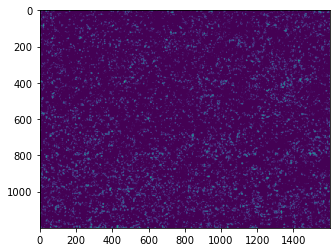

1735012


In [6]:
threshold = np.mean(diffs[0])*2.25
frame = diffs[0].copy()
condition = frame < threshold
frame[condition] = 0
plt.imshow(frame)
plt.show()
print(condition.sum())

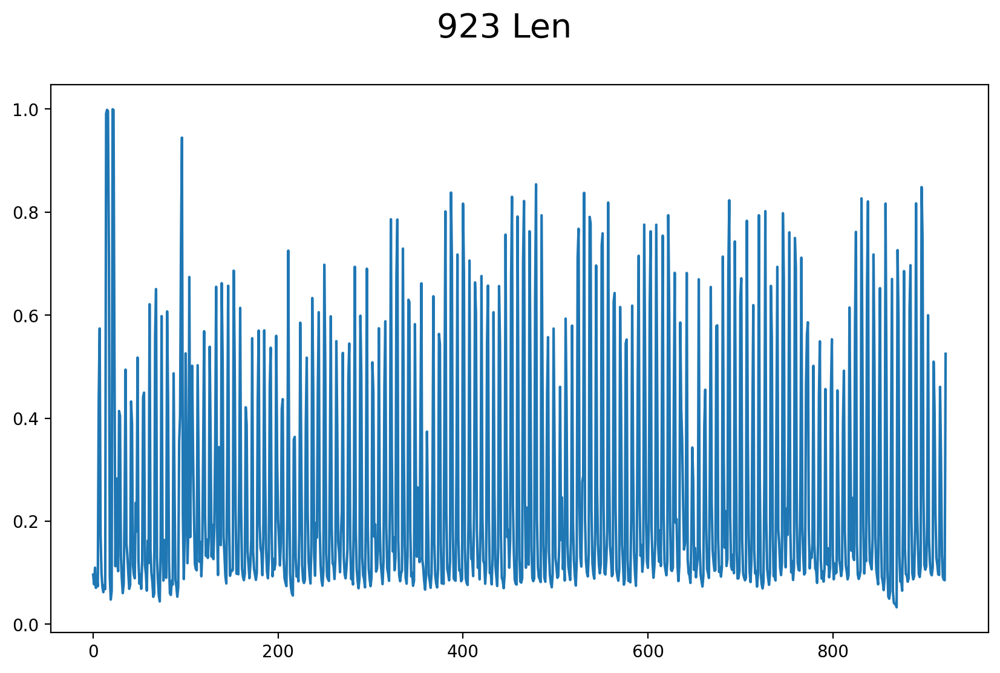

In [25]:
threshold = np.mean(diffs[0])*2.25
sums = []
means = []
for frame in diffs:
    thresholded = frame.copy()
    thresholded[frame < threshold] = 0
    thresholded[frame > threshold] = 1
#     sums.append(thresholded.sum())
    means.append(thresholded.mean())
#     plt.imshow(thresholded)
#     plt.show()
    
sums = np.array(sums)
means = np.array(means)

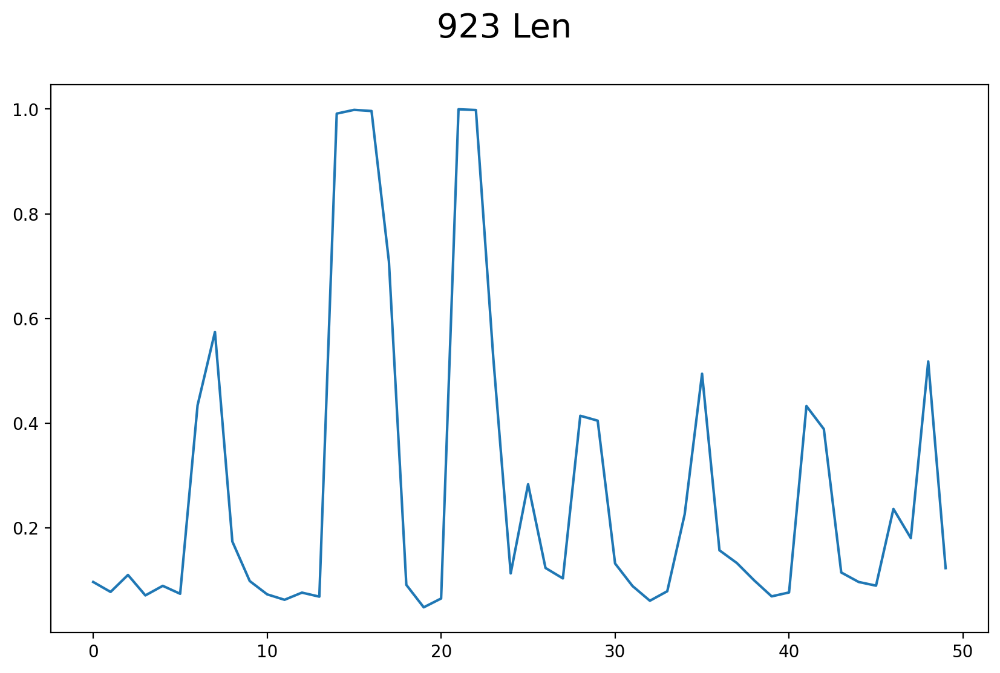

In [30]:
fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(means[0:50])
plt.suptitle(f'{len(means)} Len', fontsize=20)
plt.show()

min: 0.0328875, std: 0.11151459548005001


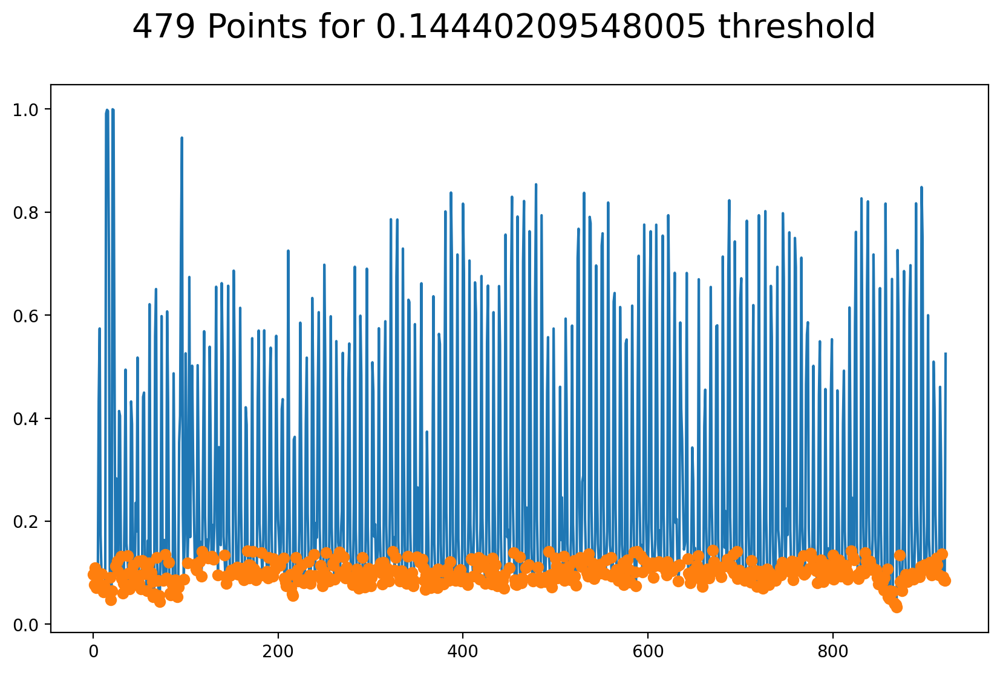

In [11]:
minimum = np.amin(means)
std = np.std(means) / 2
print(f"min: {minimum}, std: {std}")
threshold = minimum + std
hold_idxs = np.where(means < threshold)[0]

fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(means)
plt.plot(hold_idxs, means[hold_idxs], 'o')
plt.suptitle(f'{len(hold_idxs)} Points for {threshold} threshold', fontsize=20)
plt.show()

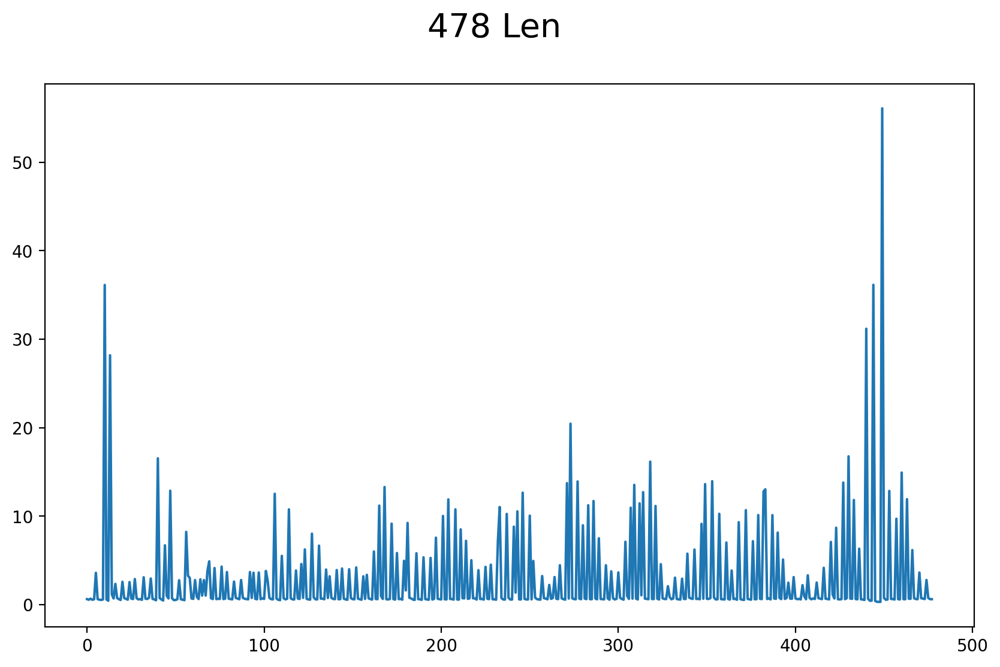

In [12]:
still_frames = vid[hold_idxs]
still_diffs = frame_differences(still_frames)
still_means = np.mean(still_diffs, axis=(1,2))

fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(still_means)
plt.suptitle(f'{len(still_means)} Len', fontsize=20)
plt.show()

In [22]:
avg = cv2.cvtColor(still_frames[0], cv2.COLOR_BGR2GRAY)
avg = cv2.GaussianBlur(avg, (5,5),cv2.BORDER_DEFAULT)
avg = avg.astype(float)
avg_frames = []

for i in range(1,len(still_frames)):
        prev = still_frames[i-1].copy()
        curr = still_frames[i].copy()

        prev = cv2.cvtColor(prev, cv2.COLOR_BGR2GRAY)
        prev = cv2.GaussianBlur(prev,(5,5),cv2.BORDER_DEFAULT)

        curr = cv2.cvtColor(curr, cv2.COLOR_BGR2GRAY)
        curr = cv2.GaussianBlur(curr,(5,5),cv2.BORDER_DEFAULT)
        
        new_avg = (curr + avg) / 2
        diff = cv2.absdiff(new_avg, avg) / avg
        
        if np.mean(diff) > 0.01:
            avg_frames.append(i)
            avg = new_avg
            
avg_frames = still_frames[avg_frames]

(278, 1200, 1600, 3)


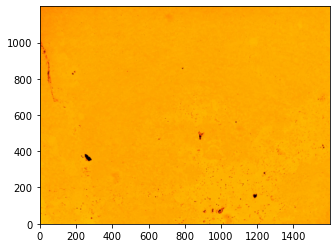

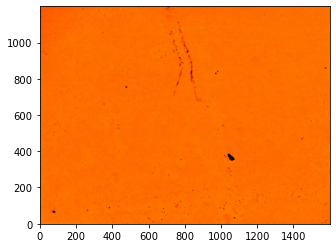

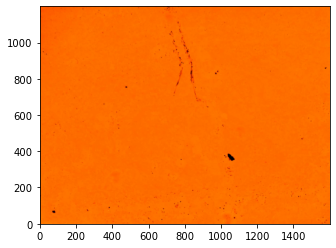

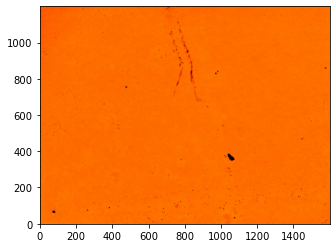

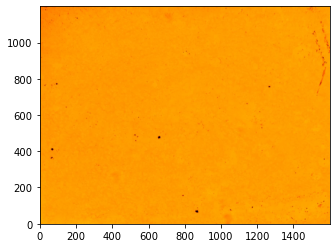

...

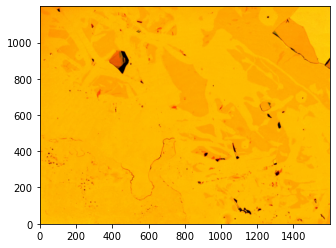

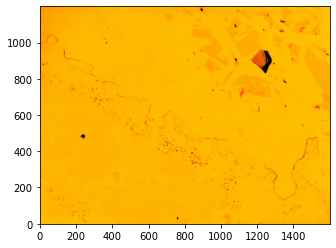

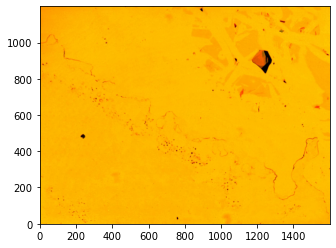

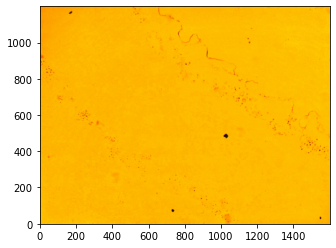

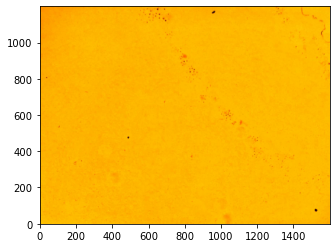

In [23]:
print(avg_frames.shape)
fig = plt.figure()
for frame in avg_frames:
    plt.imshow(frame, origin = 'lower')
    plt.show()

In [21]:
means = np.mean(diffs, axis=(1,2))
means.shape

(923,)

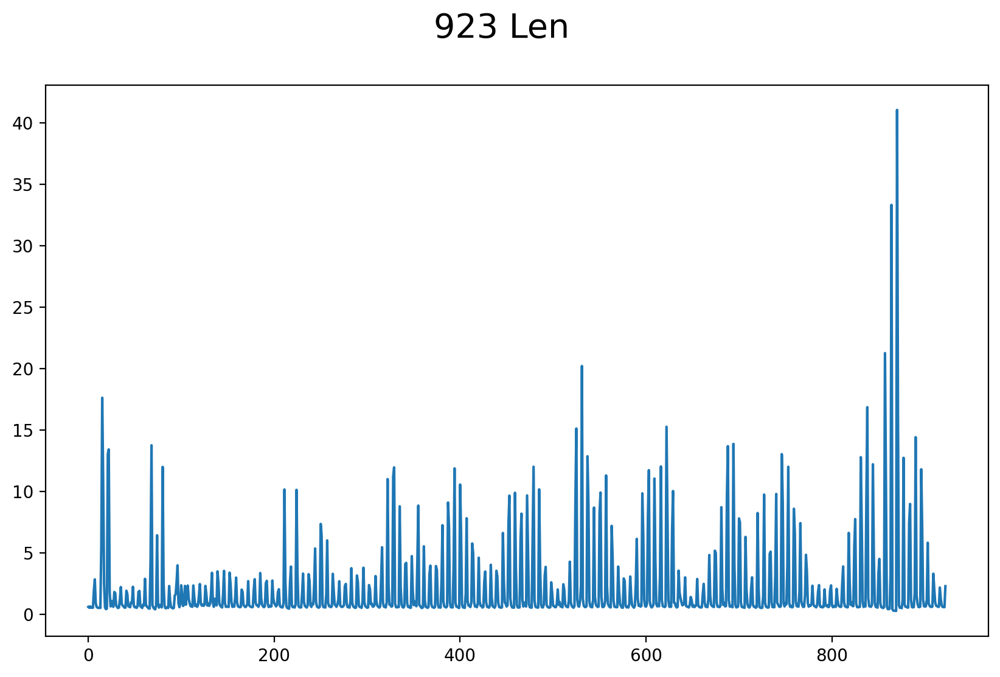

In [22]:
miniumum = np.amin(means)
threshold = 0.2
hold_idxs = np.where(means < threshold)[0]

fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(means)
plt.suptitle(f'{len(means)} Len', fontsize=20)
plt.show()

In [ ]:
plt.plot(means[0:100])

In [ ]:
plt.plot(means[0:100])
plt.plot(low_idx, means[low_idx], 'o')
plt.show()

In [ ]:
dmeans = np.gradient(means)
plt.plot(dmeans[0:100])
plt.suptitle(f'{len(dmeans)} Len', fontsize=20)
plt.show()

In [ ]:
threshold = 0.04
low_idx = np.absolute(dmeans[0:100]) < threshold
print(len(low_idx))
y = np.zeros(low_idx.shape)
idxs = np.where(low_idx)[0]

fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(dmeans[0:100])
plt.plot(idxs, dmeans[idxs], 'o')
plt.suptitle(f'{len(idxs)} Points', fontsize=20)
plt.show()

In [ ]:
fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(means)
plt.plot(idxs, means[idxs], 'o')
plt.suptitle(f'{len(idxs)} Points', fontsize=20)
plt.show()

In [ ]:
fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(means[0:100])
plt.plot(idxs, means[idxs], 'o')
plt.suptitle(f'{len(idxs[0:100])} Points', fontsize=20)
plt.show()

In [ ]:
ddmeans = np.gradient(dmeans)
threshold = 0.04
llow_idx = np.absolute(ddmeans[0:100]) < threshold
y = np.zeros(llow_idx.shape)
lidxs = np.where(llow_idx)[0]

fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(ddmeans[0:100])
plt.plot(lidxs, ddmeans[lidxs], 'o')
plt.suptitle(f'{len(idxs)} Points', fontsize=20)
plt.show()

In [ ]:
fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(means[0:100])
plt.plot(lidxs, means[lidxs], 'o')
plt.suptitle(f'{len(idxs[0:100])} Points', fontsize=20)
plt.show()

In [ ]:
miniumum = np.amin(means)
threshold = miniumum*2.25
low_idx = np.absolute(means) < threshold
hold_idxs = np.where(low_idx)[0]

fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(means)
plt.plot(hold_idxs, means[hold_idxs], 'o')
plt.suptitle(f'{len(hold_idxs)} Points for {threshold} threshold', fontsize=20)
plt.show()

In [ ]:
hold_frames = vid[hold_idxs]
means = []
for i in range(1, len(hold_frames)):
    prev = hold_frames[i-1]
    curr = hold_frames[i]
    
    prev = cv2.cvtColor(prev, cv2.COLOR_BGR2GRAY)
    prev = cv2.GaussianBlur(prev,(5,5),cv2.BORDER_DEFAULT)
    
    curr = cv2.cvtColor(curr, cv2.COLOR_BGR2GRAY)
    curr = cv2.GaussianBlur(curr,(5,5),cv2.BORDER_DEFAULT)
    
    diff = cv2.absdiff(curr, prev)
    means.append(np.mean(diff))
    
means = np.array(means)

In [ ]:
fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(means)
plt.suptitle(f'{len(means)} Points', fontsize=20)
plt.show()

In [ ]:
miniumum = np.amin(means)
threshold = miniumum*2.25
low_idx = np.absolute(means) < threshold
hold_idxs2 = np.where(low_idx)[0]

fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(means)
plt.plot(hold_idxs2, means[hold_idxs2], 'o')
plt.suptitle(f'{len(hold_idxs2)} Points for {threshold} threshold', fontsize=20)
plt.show()

In [ ]:
diffs = []
tmp = 0

# want to remove images which are similar
for idx in range(1, len(hold_idxs2)):
    i = hold_idxs2[i-1]
    j = hold_idxs2[i]
    
    prev = vid[i]
    curr = vid[j]
    
    prev = cv2.cvtColor(prev, cv2.COLOR_BGR2GRAY)
    prev = cv2.GaussianBlur(prev,(5,5),cv2.BORDER_DEFAULT)
    
    curr = cv2.cvtColor(curr, cv2.COLOR_BGR2GRAY)
    curr = cv2.GaussianBlur(curr,(5,5),cv2.BORDER_DEFAULT)
    
    diff = cv2.absdiff(curr, prev)
    means.append(np.mean(diff))
    
means = np.array(means)

In [ ]:
miniumum = np.amin(means)
threshold = miniumum*2.25
low_idx = np.absolute(means) < threshold
hold_idxs = np.where(low_idx)[0]
hold_frames = vid[hold_idxs]
for k in range(3):
    means_i = []
    for i in range(1, len(hold_frames)):
        prev = hold_frames[i-1]
        curr = hold_frames[i]

        prev = cv2.cvtColor(prev, cv2.COLOR_BGR2GRAY)
        prev = cv2.GaussianBlur(prev,(5,5),cv2.BORDER_DEFAULT)

        curr = cv2.cvtColor(curr, cv2.COLOR_BGR2GRAY)
        curr = cv2.GaussianBlur(curr,(5,5),cv2.BORDER_DEFAULT)

        diff = cv2.absdiff(curr, prev)
        means_i.append(np.mean(diff))

    means_i = np.array(means_i)
    miniumum = np.amin(means_i)
    threshold = miniumum*2.25
    hold_idxs = np.absolute(means_i) < threshold
    hold_idxs = np.where(hold_idxs)[0]
    hold_frames = vid[hold_idxs]
    
fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(means)
plt.plot(hold_idxs, means[hold_idxs], 'o')
plt.suptitle(f'{len(hold_idxs)} Points for {threshold} threshold', fontsize=20)
plt.show()

In [ ]:
def non_maximum_suppression1D(signal):
    l = len(signal)
    
    # Allocate memory for suppressed image
    output = np.zeros(l, dtype=np.int32)
        
    # edge direction angle is rounded to one of four angles representing vertical, horizontal and the two diagonals (0°, 45°, 90° and 135°). 
    # The positive y axis is down the image (increasing row index) and the positive x axis is rightward on the image (increasing column index)
    for i in range(1, l-1):
        p = 255
        q = 255
        
        p = signal[i-1]
        q = signal[i+1]
        
        # Set this pixel to zero intenisty if it is not the maximum of the three candidates
        if (signal[i] >= p) and (signal[i] >= q):
            output[i] = signal[i]
        else:
            output[i] = 0
    
    print(len(output))
    # return supressed image
    return output

In [ ]:
threshold = 0.75
low_idx = np.absolute(means) < threshold
hold_idxs = np.where(low_idx)[0]

supressed_idxs = non_maximum_suppression1D(hold_idxs)

fig = plt.figure(figsize=(10, 6), dpi=200)
plt.plot(means)
plt.plot(supressed_idxs, means[supressed_idxs], 'o')
plt.suptitle(f'{len(supressed_idxs)} Points', fontsize=20)
plt.show()

In [ ]:
from scipy.signal import find_peaks, peak_prominences, savgol_filter

def locate_peaks(signal,filter_window_length=0,filter_polyorder=1,finder_prominence=0, width=1):
    """
    Search through the data and find peaks.
    """
    # Smooth data before peak finding (to reduce the influence of noise)
    if filter_window_length: signal = savgol_filter(signal, filter_window_length, filter_polyorder)
    
    # Find the peaks in the denoised intensity data.
    peak_indices, peak_properties = find_peaks(signal, prominence=finder_prominence, wlen=30, width=width)
    return peak_indices , peak_properties

In [ ]:
import scipy.fftpack
N = 100
x = np.linspace(0,2*np.pi,N)
y = means

w = scipy.fftpack.rfft(y)
f = scipy.fftpack.rfftfreq(N, x[1]-x[0])
spectrum = w**2

cutoff_idx = spectrum < (spectrum.max()/5)
w2 = w.copy()
w2[cutoff_idx] = 0

y2 = scipy.fftpack.irfft(w2)

In [ ]:
from scipy.signal import savgol_filter
yhat = savgol_filter(means, 7, 3) # window size 51, polynomial order 3
plt.plot(yhat)

In [ ]:
def show_peaks(curve):
    peak_info = locate_peaks(curve, filter_window_length=3, finder_prominence=5, width=10)
    peak_indices = peak_info[0]
    peak_properties = peak_info[1]
    plt.suptitle(f'{len(peak_indices)} Peaks', fontsize=20)
    plt.plot(curve)
    plt.plot(peak_indices, curve[peak_indices], 'o')
    plt.show()

In [ ]:
show_peaks(means[25:65])

In [ ]:
idx = yhat[peak_indices]
idx = idx.astype(int)
peak_indices

In [15]:
frames = vid[hold_idxs]
frames.shape

(479, 1200, 1600, 3)

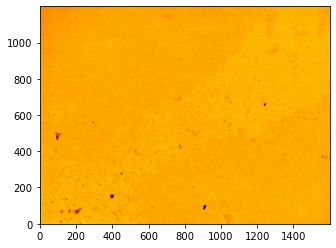

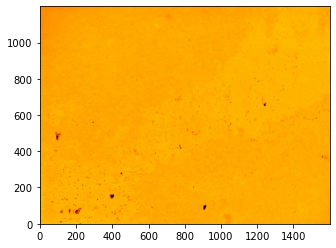

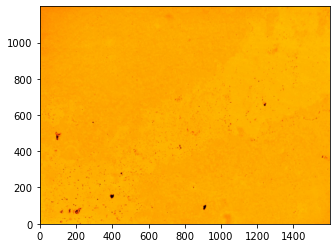

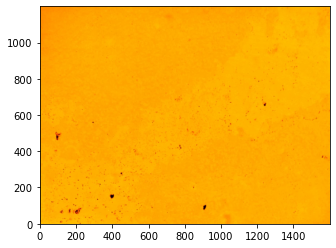

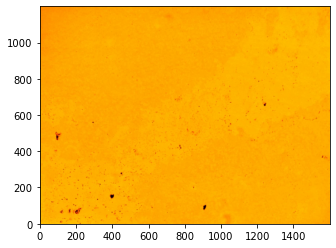

...

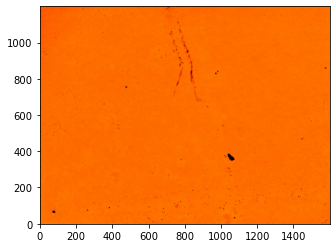

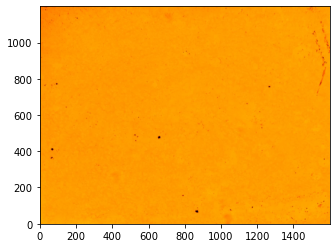

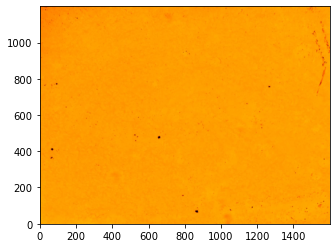

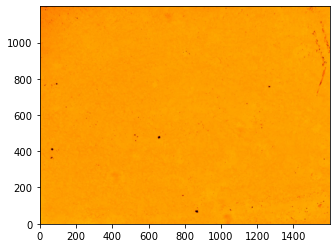

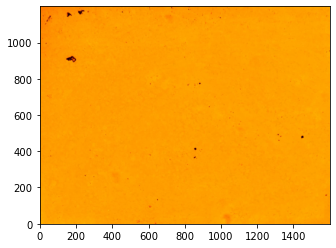

KeyboardInterrupt: 

In [16]:
fig = plt.figure()

for frame in frames:
    plt.imshow(frame, origin = 'lower')
    plt.show()